In [1]:
import os
import glob as glob
import matplotlib.pyplot as plt
import numpy as np
import cv2
import random
import requests

SEED = 42
np.random.seed(SEED)

In [2]:
!ls

data.yaml  README.dataset.txt  README.roboflow.txt  sample_data  test  train  valid  yolov5


## Hyperparameters and Constants

Here, we define wether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [3]:
TRAIN = True
# number of epochs to train for
EPOCHS = 25

# Download and Prepare the Dataset

We will use the <a href="https://public.roboflow.com/object-detection/vehicles-openimages" target="_blank">Vehicles-OpenImages</a> dataset for training the custom YOLOv5 object detector.

Let's download the dataset.

In [4]:
if not os.path.exists("train"):
    !curl -L "https://public.roboflow.com/ds/xKLV14HbTF?key=aJzo7msVta" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

    dirs = ['train', 'valid', 'test']

    for i, dir_name in enumerate(dirs):
      all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
      for j, image_name in enumerate(all_image_names):
        if(j % 2) == 0:
          file_name = image_name.split(".jpg")[0]
          os.remove(f"{dir_name}/images/{image_name}")
          os.remove(f"{dir_name}/labels/{file_name}.txt")


The dataset is structured in the following manner:

```
├── data.yaml
├── README.dataset.txt
├── README.roboflow.txt
├── test
│   ├── images
│   └── labels
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

In [5]:
class_names = ['Car', 'Truck', 'Bus', 'Motorcycle', 'Ambulance']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [6]:
#Function to convert bounding boxes in YOLO format to xmin, Ymin, xmax, ymax

def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [7]:
def plot_boxes(image, bboxes, labels):
    #need the image height and width to denormalize
    #the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        #denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            colors[class_names.index(class_name)],
            thickness=2
        )

        front_scale = min(1,max(3,int(w/500)))
        front_thickness = min(2,max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymin))
        # text width and height
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=front_scale, thickness=front_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            front_scale,
            (255, 255, 255),
            front_thickness,
        )
    return image

In [8]:
#function to plot images with the bounding boxes

def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_boxes(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')

    plt.subplots_adjust(wspace=0.1)
    plt.tight_layout()
    plt.show()

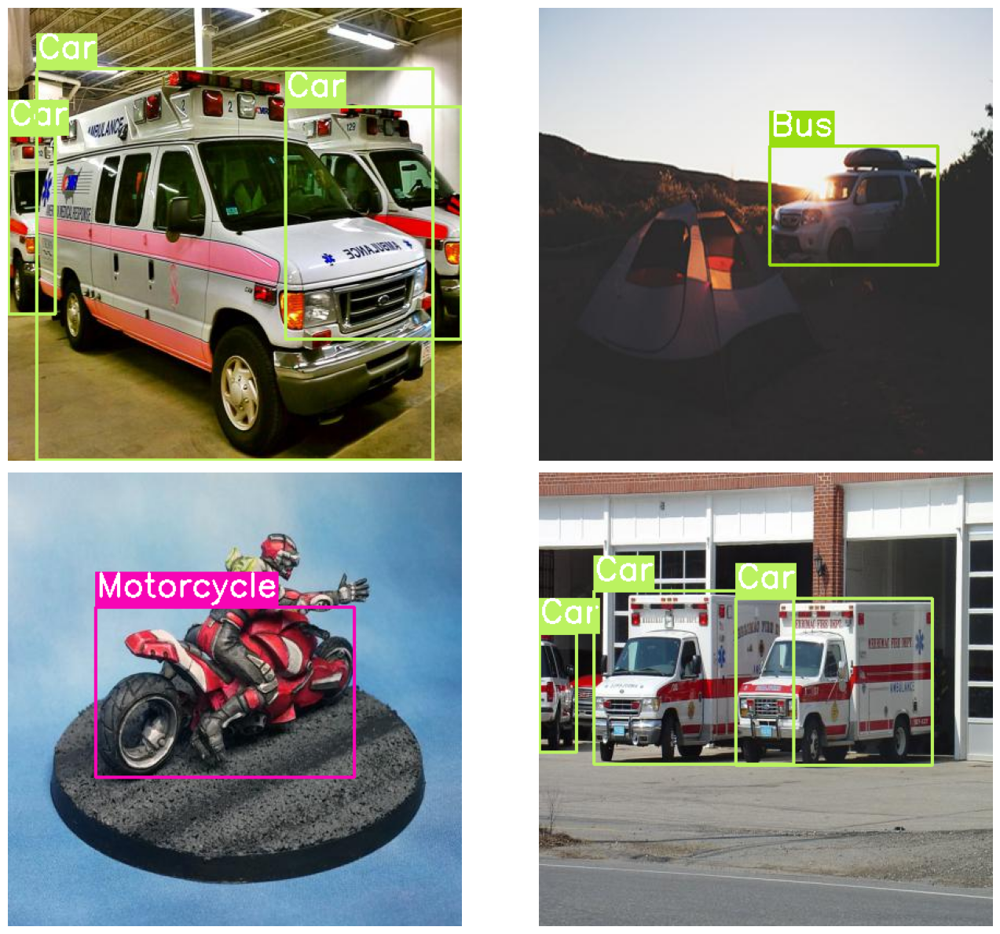

In [9]:
#visualize a few training images
plot(
    image_paths='train/images/*',
    label_paths='train/labels/*',
    num_samples=4,
)

In [10]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [11]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [12]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

In [13]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [14]:
!pip install -r requirements.txt

## Training using YOLOV5
The next step is to train the neural network model.
### Train a Small (yolov5s) Model

Training all the layers of the small model.


In [15]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

In [16]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5s.pt --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}


Current number of result directories: 1
results_2
2024-09-04 19:07:39.450685: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-04 19:07:39.501577: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-04 19:07:39.514903: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False

#visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training.The following is the function for that.

In [24]:
#function to show validate predictions saved during training.
def show_valid_results(RES_DIR):
  !ls runs/train/{RES_DIR}
  EXP_PATH = f'runs/train/{RES_DIR}'
  validation_pred_images = glob.glob(f'{EXP_PATH}/*_pred.jpg')
  print(validation_pred_images)
  for pred_image in validation_pred_images:
    image = cv2.imread(pred_image)
    plt.figure(figsize=(19, 16))
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

The following function are for carrying out interence on images and videos.

In [25]:
# Helper function for inferences on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images in any of the directories.The following function accepts a directory path plots

In [26]:
rnd_array = np.random.randint(0, 50, size=10)

In [27]:
#picks random photos from any directory randomly and displays it!
def visualize(INFER_DIR):
    # visualize inference images.
    INFER_PATH = f'runs/detect/{INFER_DIR}'
    inference_images = glob.glob(f'{INFER_PATH}/*.jpg')
    for i,pred_image in enumerate(inference_images):
      if i == 4:
        break
      image = cv2.imread(pred_image)
      plt.figure(figsize=(12, 9))
      plt.imshow(image[:, :, ::-1])
      plt.axis('off')
      plt.show()


Visualize validation prediction images.

confusion_matrix.png				    PR_curve.png	   val_batch0_pred.jpg
events.out.tfevents.1725476863.605829e82717.8919.0  R_curve.png		   val_batch1_labels.jpg
F1_curve.png					    results.csv		   val_batch1_pred.jpg
hyp.yaml					    results.png		   val_batch2_labels.jpg
labels_correlogram.jpg				    train_batch0.jpg	   val_batch2_pred.jpg
labels.jpg					    train_batch1.jpg	   weights
opt.yaml					    train_batch2.jpg
P_curve.png					    val_batch0_labels.jpg
['runs/train/results_2/val_batch2_pred.jpg', 'runs/train/results_2/val_batch1_pred.jpg', 'runs/train/results_2/val_batch0_pred.jpg']


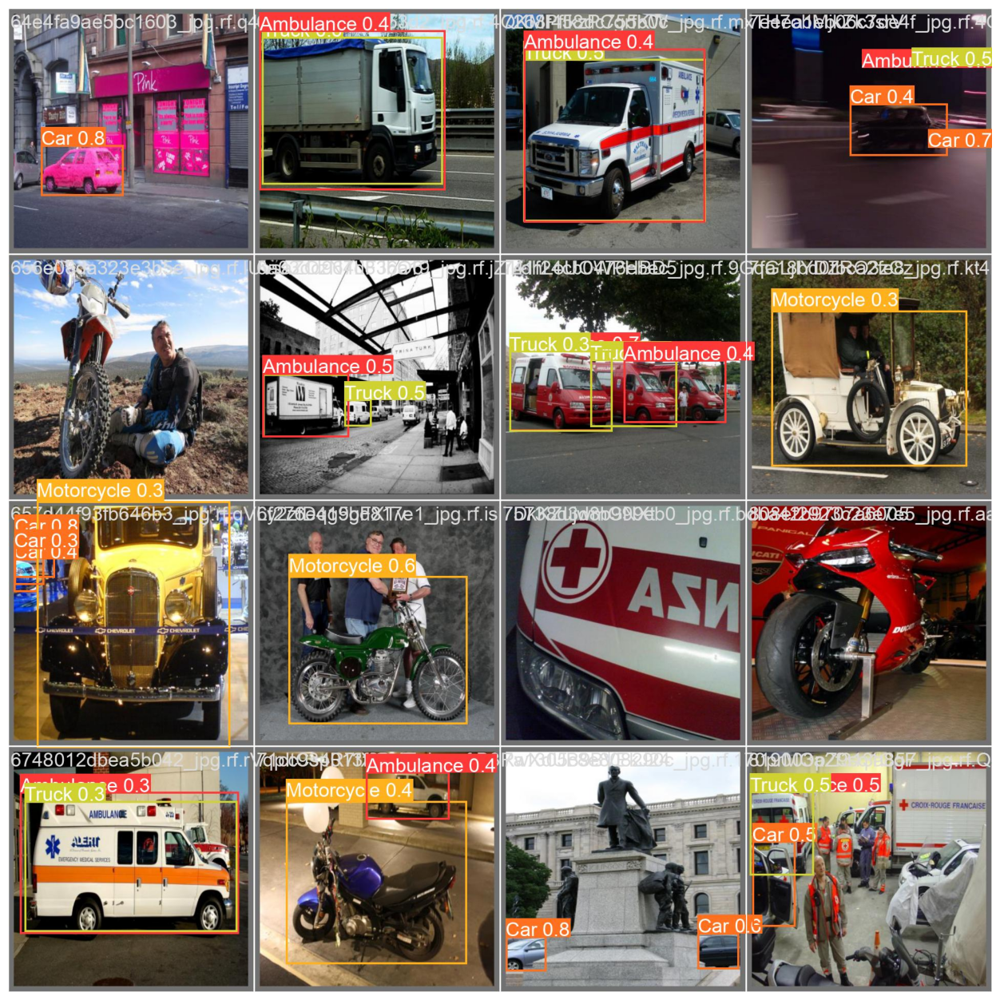

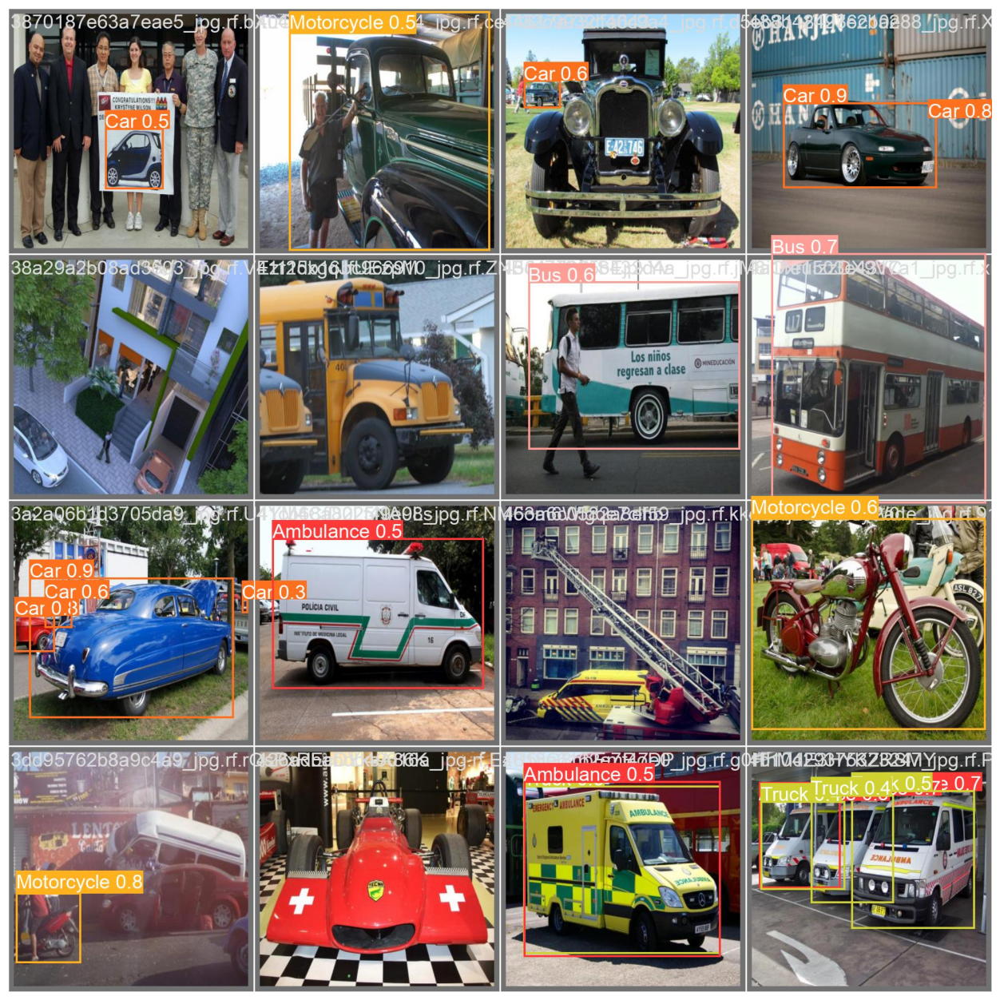

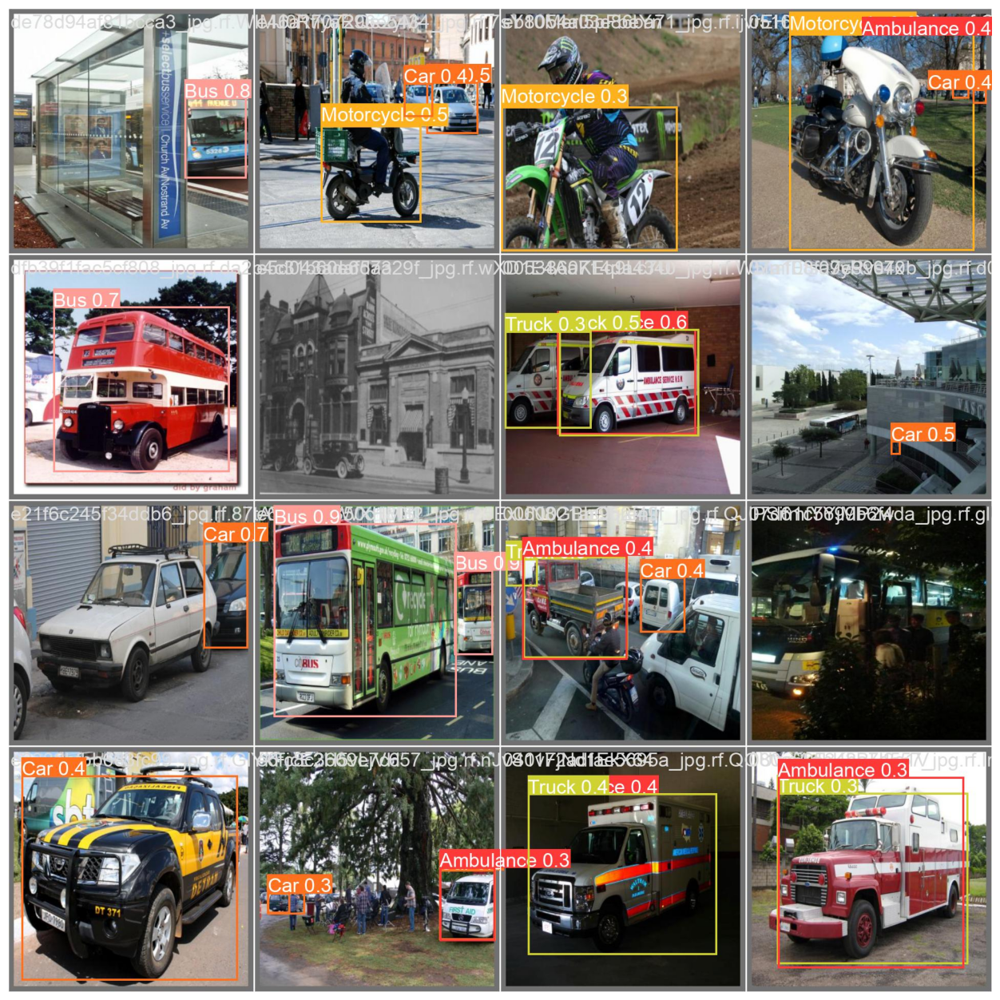

In [28]:
show_valid_results(RES_DIR)

#Inference on Images

to carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.

In [29]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images')

Current number of inference directories: 4
inference_5
detect: weights=['runs/train/results_2/weights/best.pt'], source=../test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_5, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-364-g4d39325f Python-3.10.12 torch-2.4.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/63 /content/test/images/00dea1edf14f09ab_jpg.rf.KJ730oDTFPdXdJxvSLnX.jpg: 640x640 1 Ambulance, 1 Truck, 11.4ms
image 2/63 /content/test/images/00e481ea1a520175_jpg.rf.MV6sZ8QCFwFeMYaI2tHm.jpg: 640x640

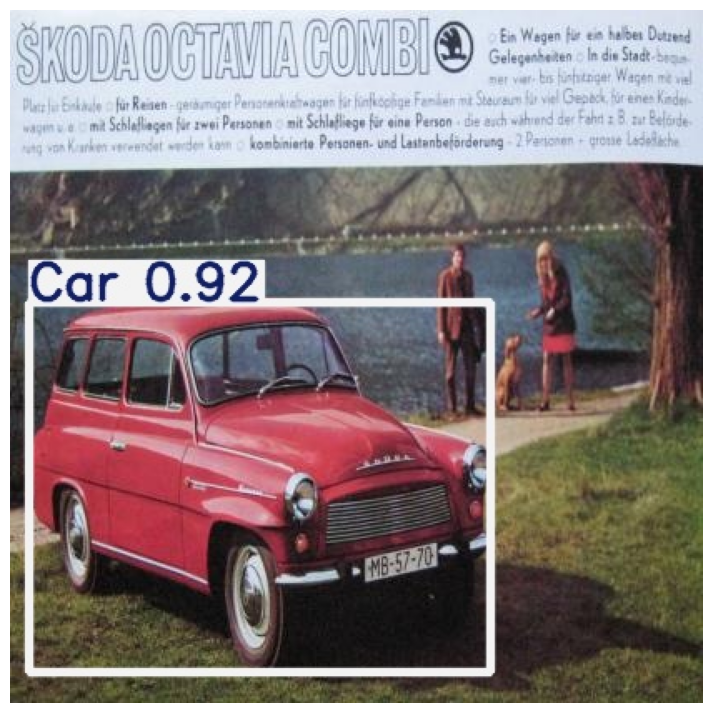

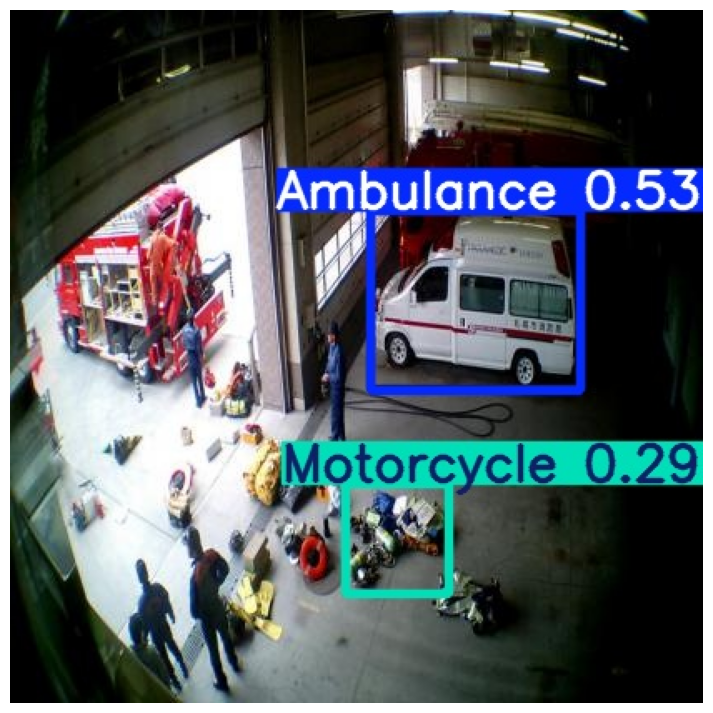

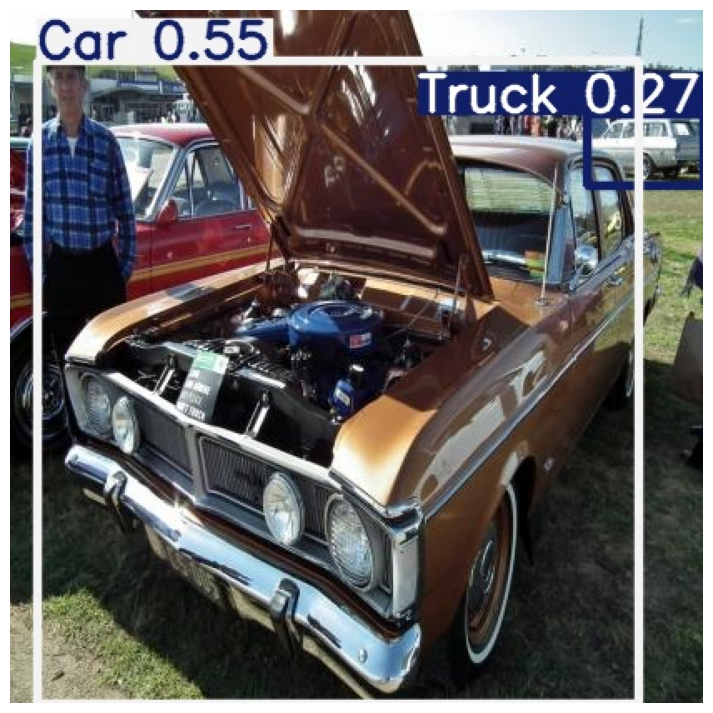

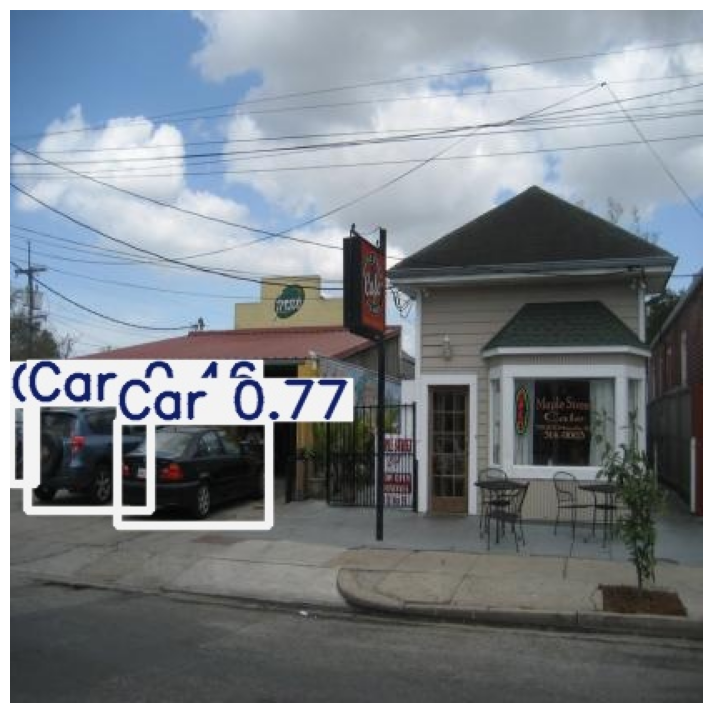

In [30]:
visualize(IMAGE_INFER_DIR)